In [1]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

In [2]:
dataset = pd.read_csv('Dataset.csv')
dataset = dataset[dataset['year'] < 2024]

In [3]:
features_data = dataset.drop(columns=['year', 'fips', 'state_name', 'county_name', 'image_name', 'per_gop', 'per_dem'])
target_data = dataset[['per_gop', 'per_dem']]

In [4]:
print("Length of feature columns:", len(features_data.columns))
print("Feature columns:", features_data.columns)

Length of feature columns: 26
Feature columns: Index(['total_votes', 'unemployment_rate', 'NPOPCHG', 'INTERNATIONALMIG',
       'DOMESTICMIG', 'RESIDUAL', 'GQESTIMATES', 'RBIRTH', 'RDEATH',
       'RNATURALINC', 'RINTERNATIONALMIG', 'RDOMESTICMIG', 'ALAND', 'AWATER',
       'adjusted_voter_turnout', 'gop_pct_avg', 'adjusted_gop_pct_estimate',
       'adjusted_gop_pct_bo_avg', 'BA_MALE_WA', 'IA_MALE_WA', 'AA_MALE_WA',
       'NA_MALE_WA', 'TOM_MALE_WA', 'NHIA_MALE_WA', 'H_FEMALE_WA',
       'HBA_MALE_WA'],
      dtype='object')


Correlation Analysis with Target

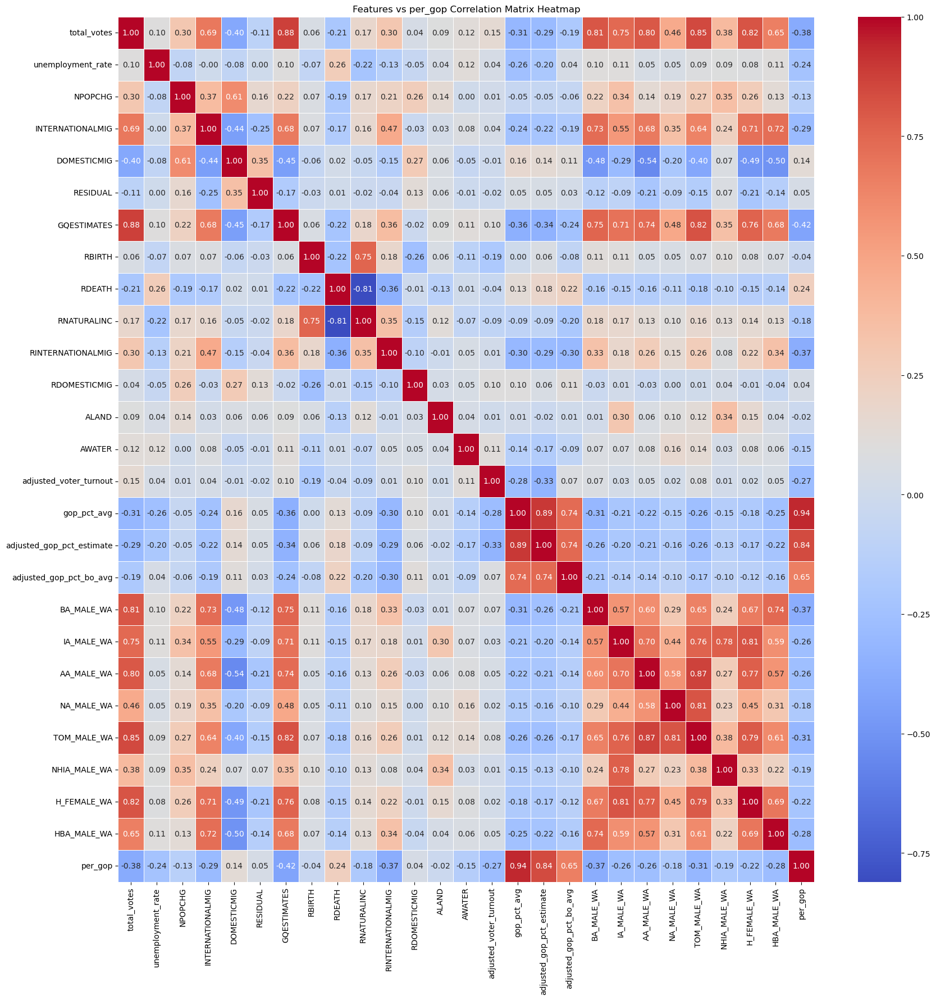

In [ ]:
df = dataset[features_data.columns.tolist() + ['per_gop']]

# Calculate the correlation matrix
correlation_matrix = df.corr()

# Create a heatmap
plt.figure(figsize=(20, 20))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title(f'Features vs per_gop Correlation Matrix Heatmap')
plt.show()


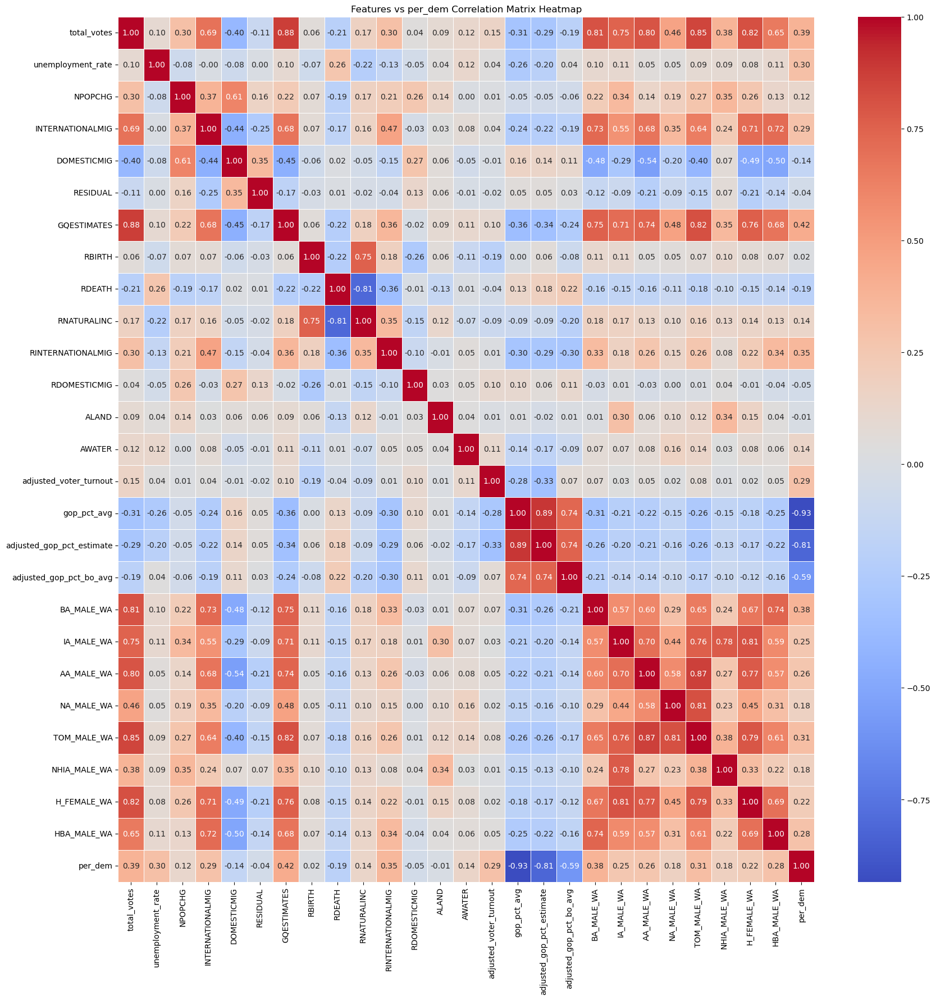

In [6]:
df = dataset[features_data.columns.tolist() + ['per_dem']]

# Calculate the correlation matrix
correlation_matrix = df.corr()

# Create a heatmap
plt.figure(figsize=(20, 20))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.5)
plt.title(f'Features vs per_dem Correlation Matrix Heatmap')
plt.show()


SCATTER-PLOTS

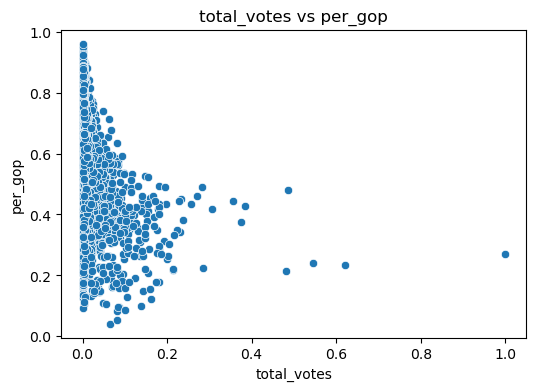

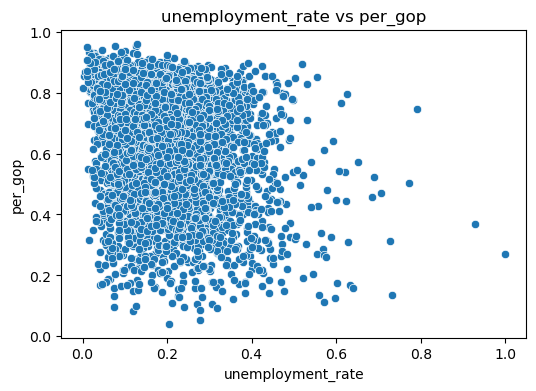

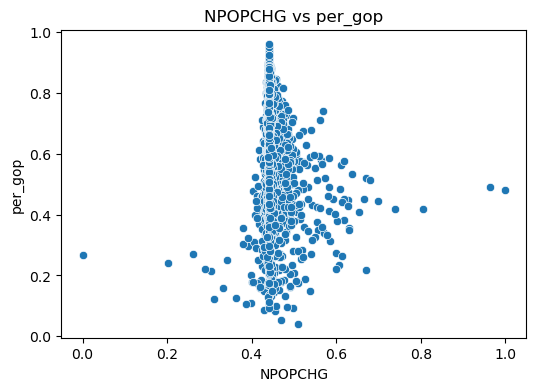

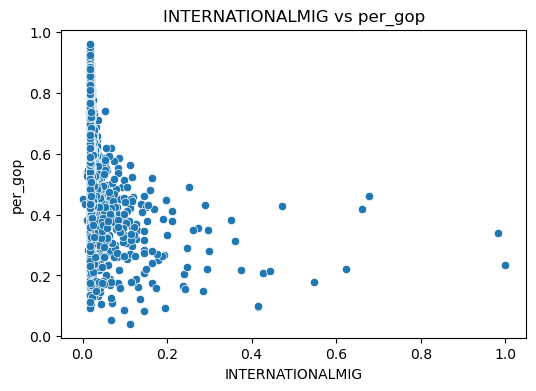

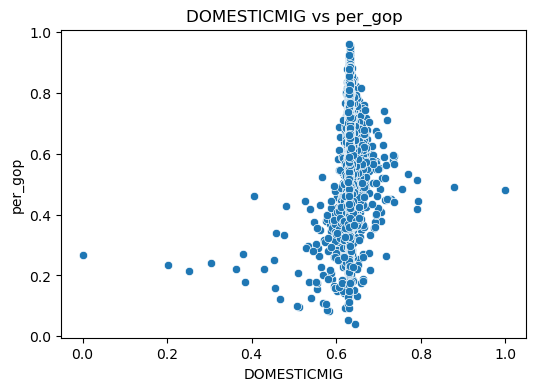

...

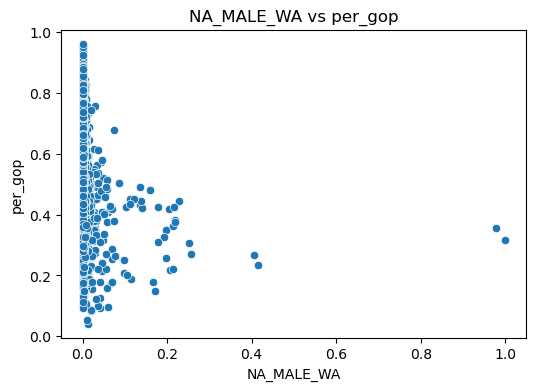

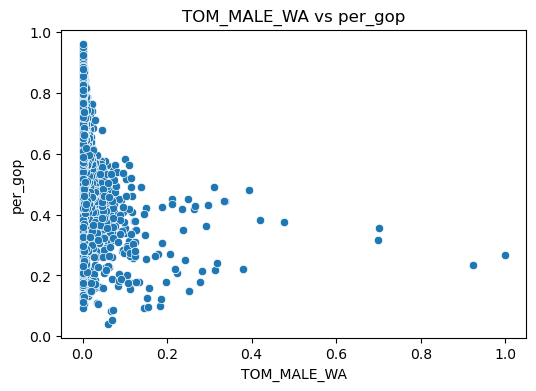

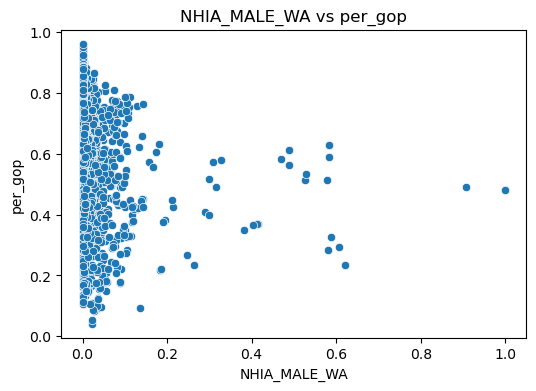

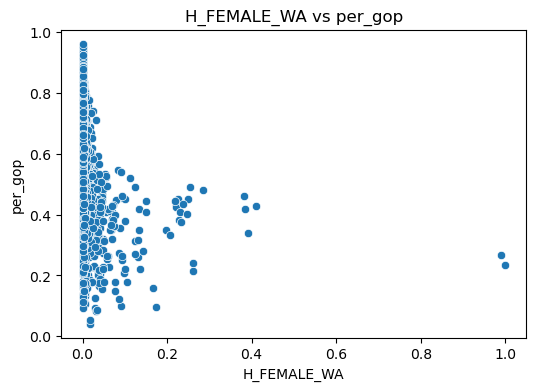

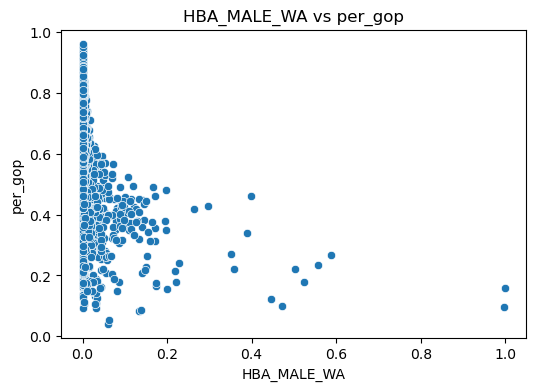

In [7]:
df = dataset[features_data.columns.tolist() + ['per_gop']]

df_scaled = df.copy()

columns_to_scale = features_data.columns

# Initialize the MinMaxScaler
scaler = MinMaxScaler()

# Fit and transform the data
df_scaled[columns_to_scale] = pd.DataFrame(scaler.fit_transform(df_scaled[columns_to_scale]))

# Plot scatter plots for each feature with the target variable
for column in df_scaled.drop(columns='per_gop').columns:
    plt.figure(figsize=(6, 4))
    sns.scatterplot(data=df_scaled, x=column, y='per_gop')
    plt.title(f'{column} vs per_gop')
    plt.show()


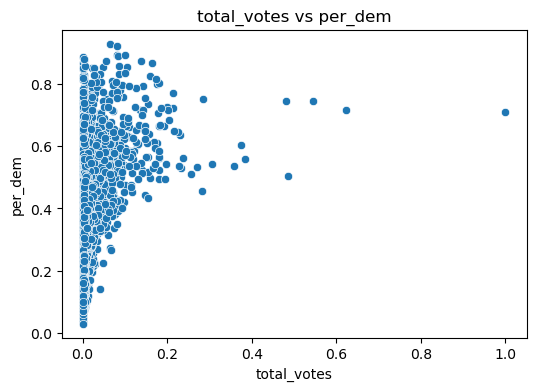

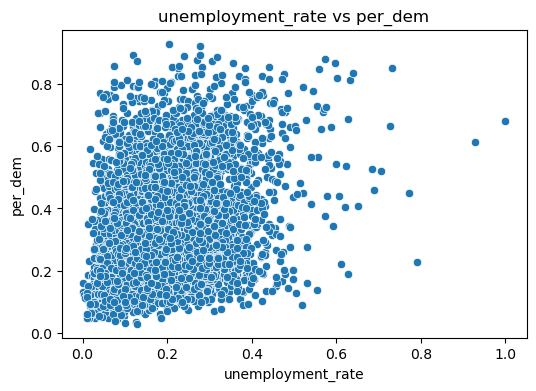

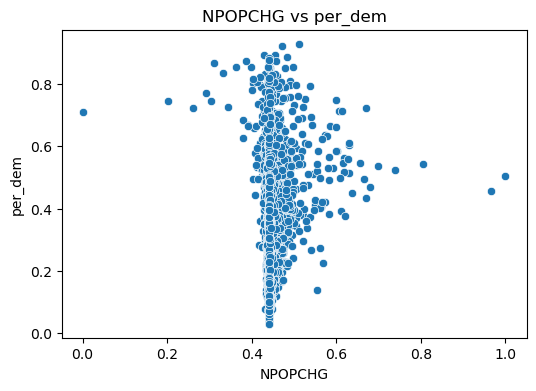

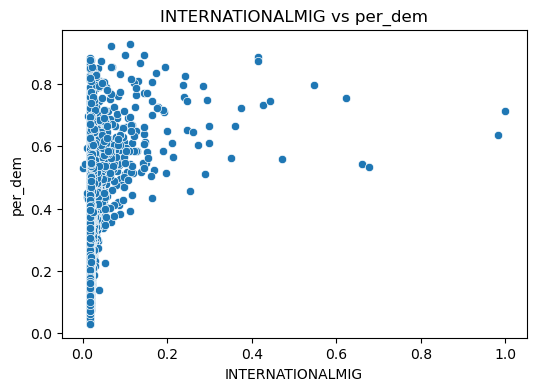

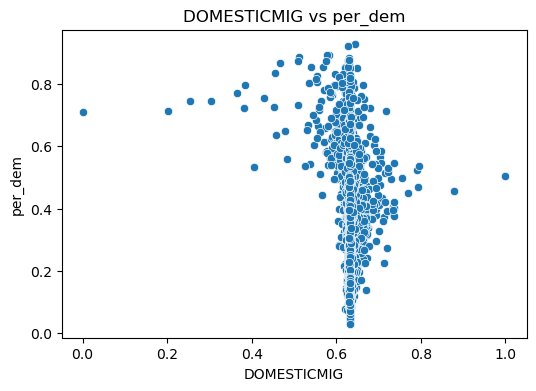

...

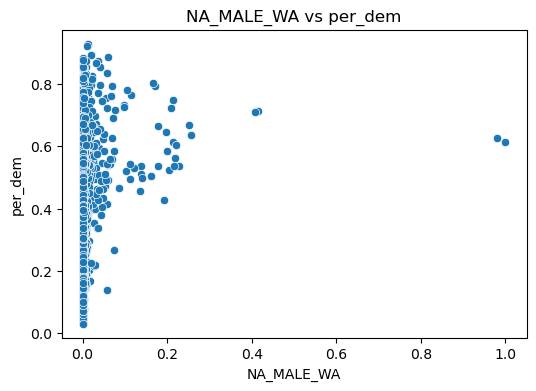

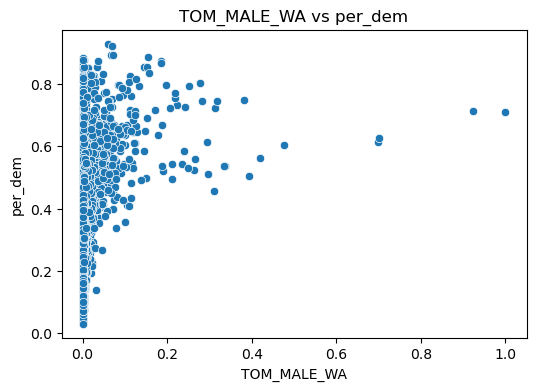

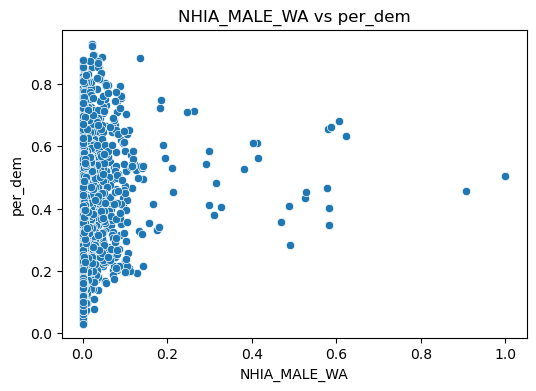

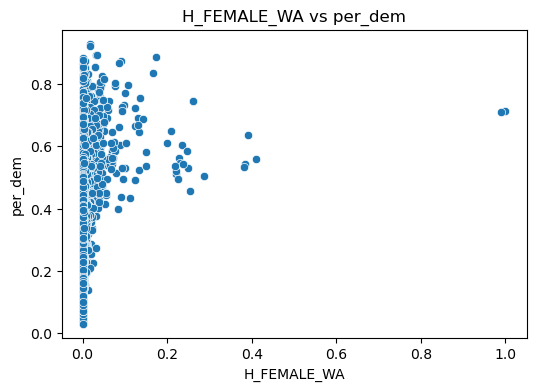

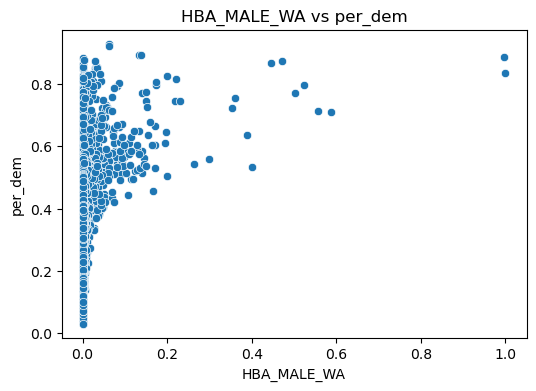

In [8]:
df = dataset[features_data.columns.tolist() + ['per_dem']]

df_scaled = df.copy()

columns_to_scale = features_data.columns

# Initialize the MinMaxScaler
scaler = MinMaxScaler()

# Fit and transform the data
df_scaled[columns_to_scale] = pd.DataFrame(scaler.fit_transform(df_scaled[columns_to_scale]))

# Plot scatter plots for each feature with the target variable
for column in df_scaled.drop(columns='per_dem').columns:
    plt.figure(figsize=(6, 4))
    sns.scatterplot(data=df_scaled, x=column, y='per_dem')
    plt.title(f'{column} vs per_dem')
    plt.show()


Correlation Matrix (Year-Wise Analysis)

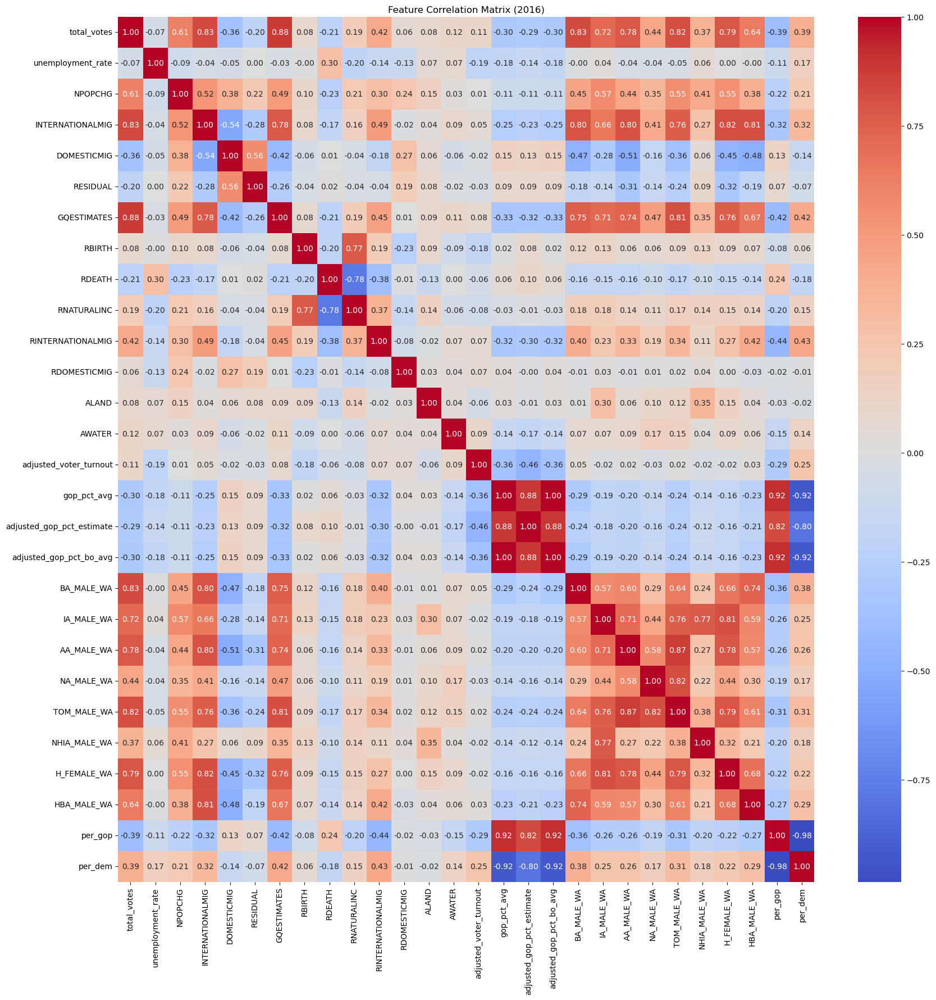

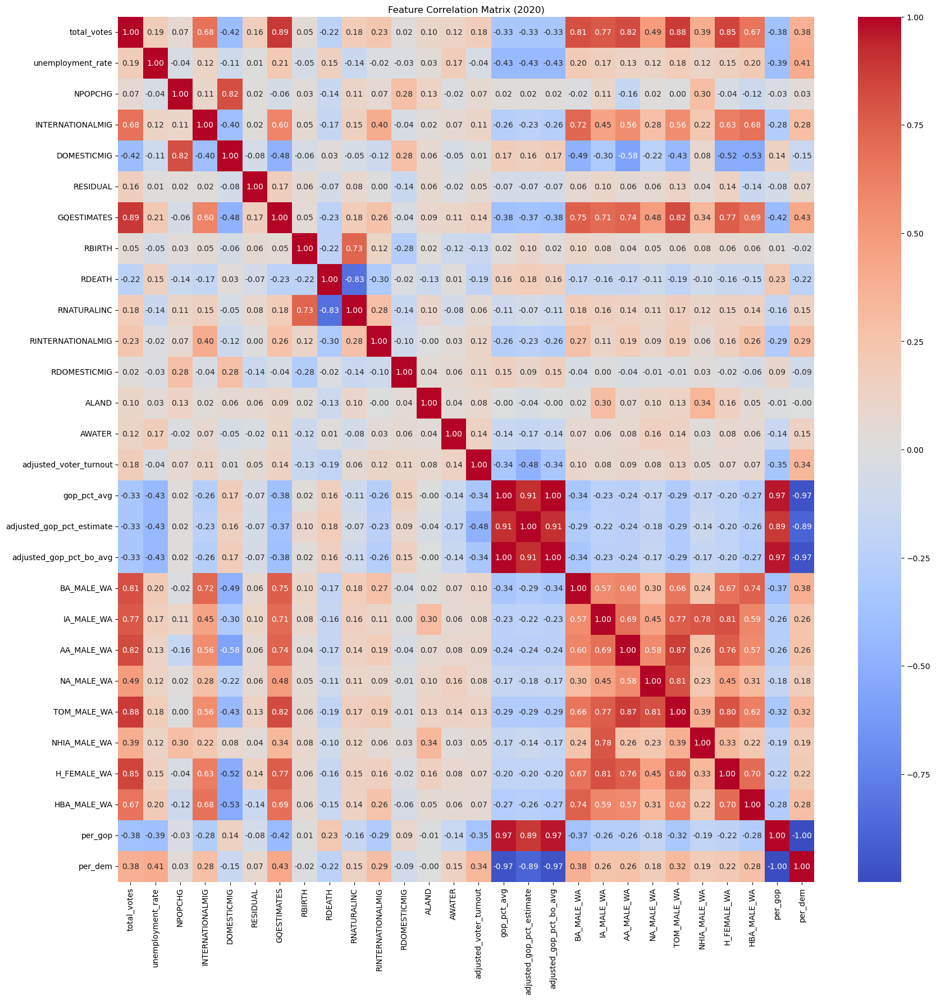

In [ ]:
df = dataset[features_data.columns.tolist() + ['year', 'per_gop', 'per_dem', 'fips']]

# Compute the correlation matrix for each year (2016 and 2020)
df_2016 = df[df['year'] == 2016]
df_2020 = df[df['year'] == 2020]

# Calculate correlation matrix for 2016
correlation_2016 = df_2016.drop(columns=['year', 'fips']).corr()
plt.figure(figsize=(20, 20))
sns.heatmap(correlation_2016, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Feature Correlation Matrix (2016)")
plt.show()

# Calculate correlation matrix for 2020
correlation_2020 = df_2020.drop(columns=['year', 'fips']).corr()
plt.figure(figsize=(20, 20))
sns.heatmap(correlation_2020, annot=True, cmap='coolwarm', fmt=".2f")
plt.title("Feature Correlation Matrix (2020)")
plt.show()


Scatter-Plots-per year

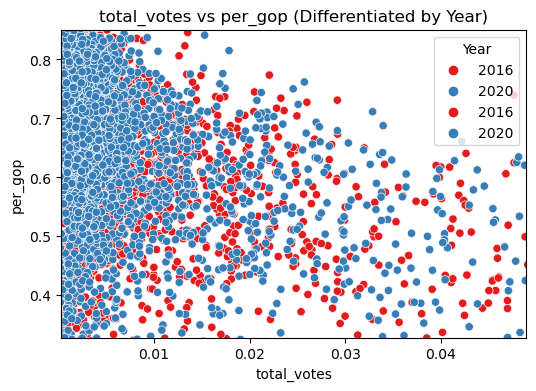

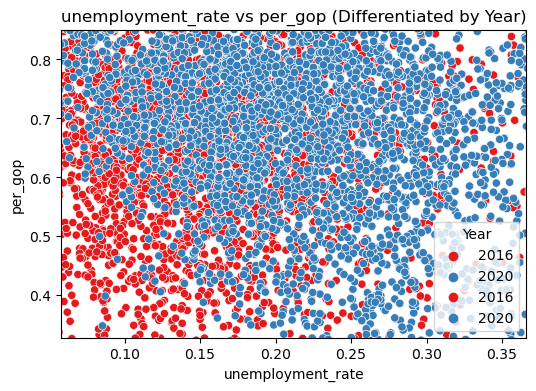

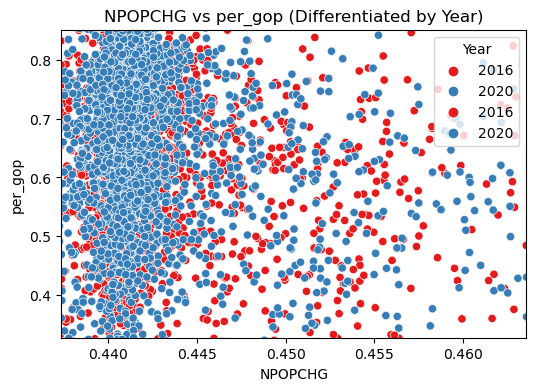

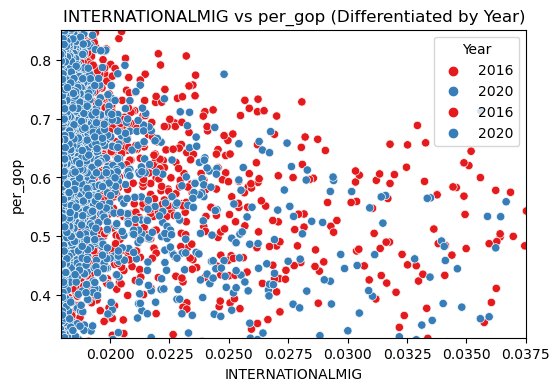

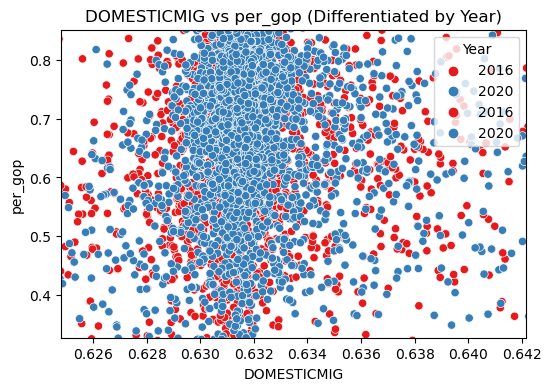

...

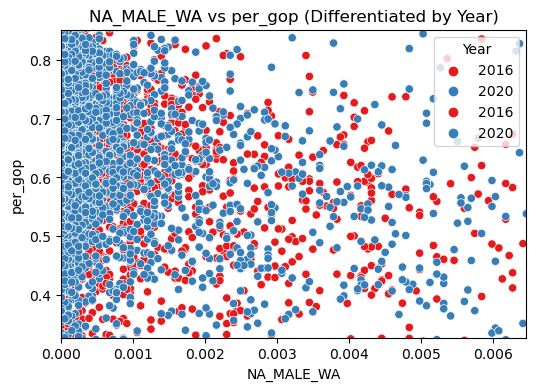

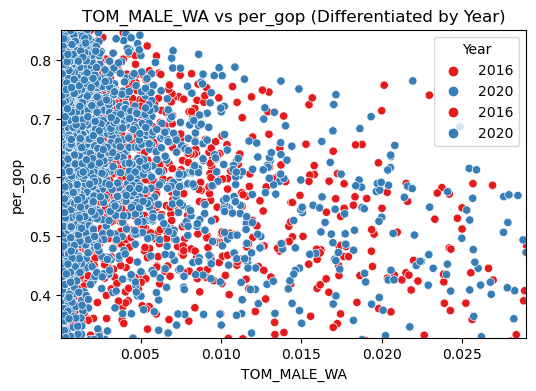

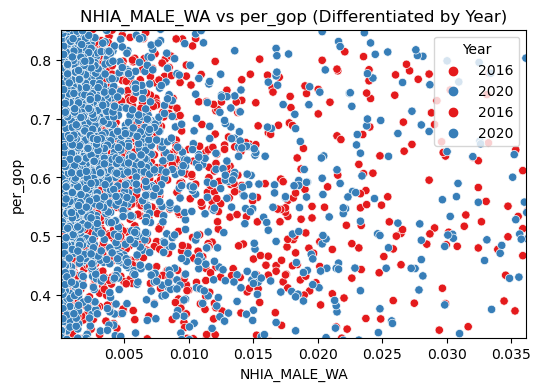

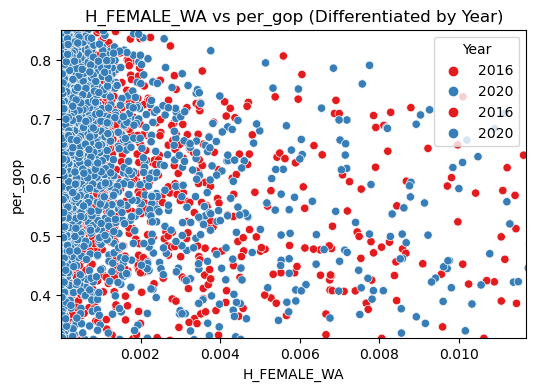

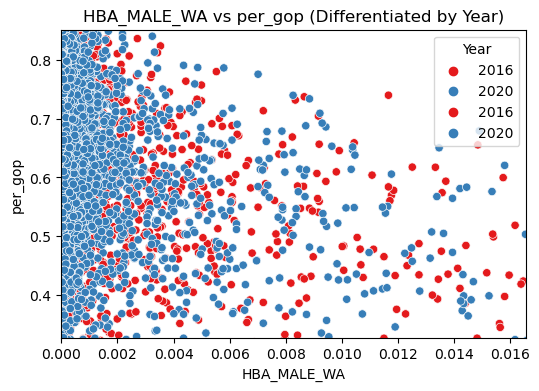

In [10]:
df = dataset[features_data.columns.tolist() + ['per_gop', 'year']]  # Include 'year' in the dataframe

df_scaled = df.copy()

columns_to_scale = features_data.columns

# Initialize the MinMaxScaler
scaler = MinMaxScaler()

# Fit and transform the data
df_scaled[columns_to_scale] = pd.DataFrame(scaler.fit_transform(df_scaled[columns_to_scale]))

# Plot scatter plots for each feature with the target variable, differentiated by year
for column in df_scaled.drop(columns=['per_gop', 'year']).columns:
    plt.figure(figsize=(6, 4))

    # Get the limits to zoom in on the data's concentration
    x_min, x_max = df_scaled[column].quantile([0.05, 0.95])  # 5th and 95th percentile for X-axis
    y_min, y_max = df_scaled['per_gop'].quantile([0.05, 0.95])  # 5th and 95th percentile for Y-axis
    
    # Plotting the scatter plot
    sns.scatterplot(data=df_scaled, x=column, y='per_gop', hue='year', palette='Set1')
    
    # Set the axis limits to zoom in
    plt.xlim(x_min, x_max)
    plt.ylim(y_min, y_max)

    sns.scatterplot(data=df_scaled, x=column, y='per_gop', hue='year', palette='Set1')  # Color by year
    plt.title(f'{column} vs per_gop (Differentiated by Year)')
    plt.legend(title='Year')  # Add legend to differentiate the years
    plt.show()


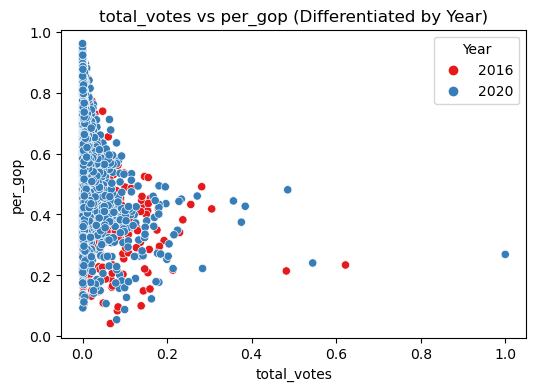

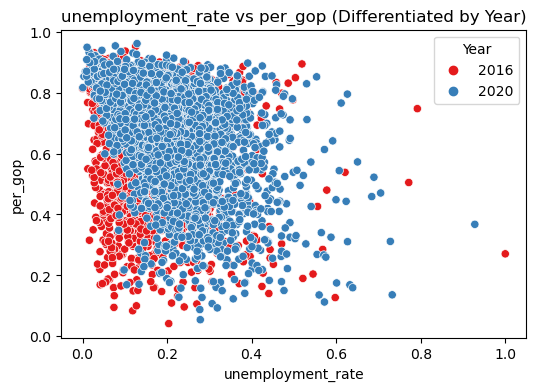

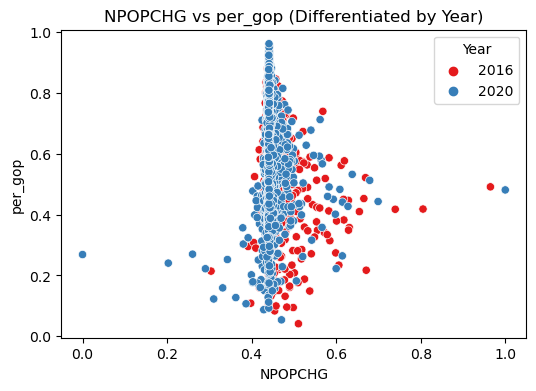

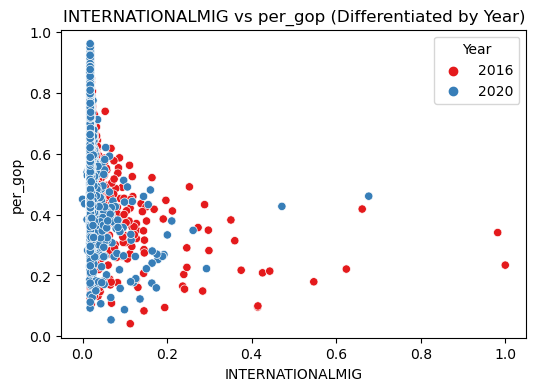

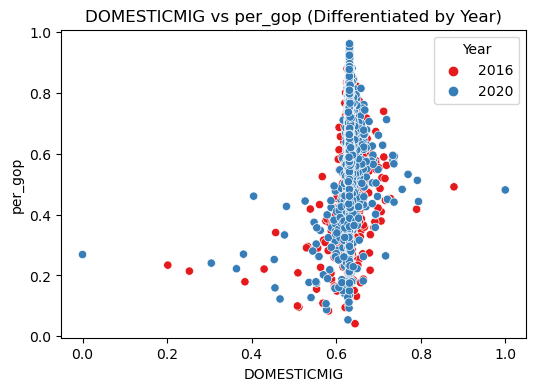

...

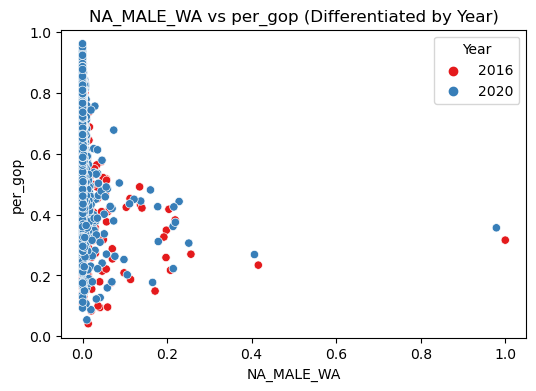

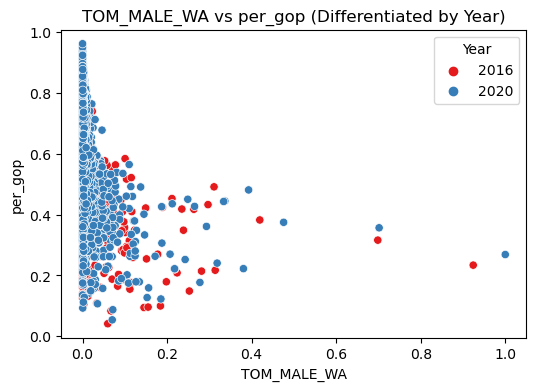

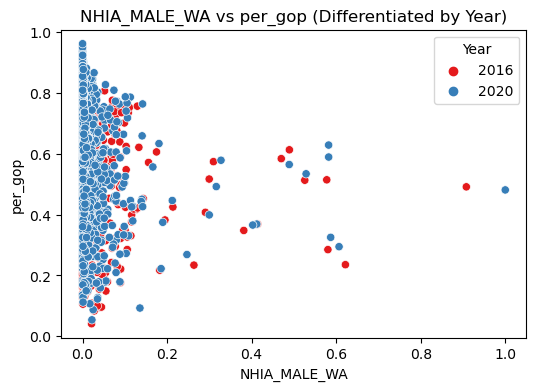

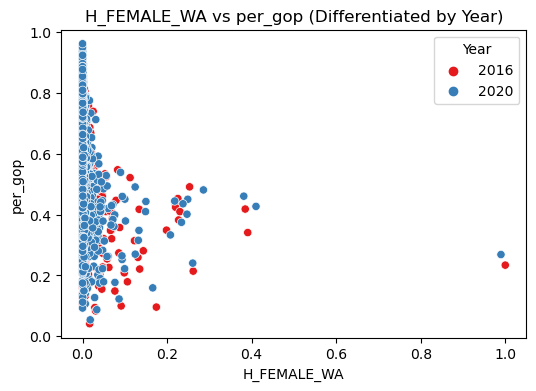

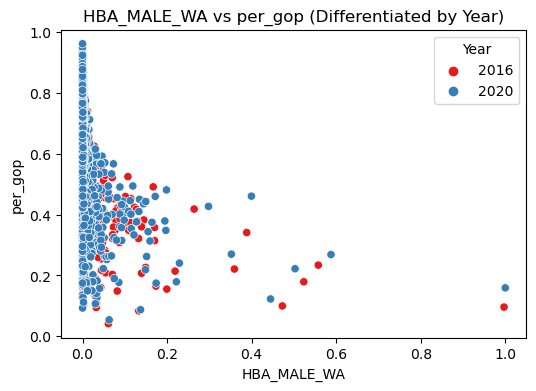

In [12]:
df = dataset[features_data.columns.tolist() + ['per_gop', 'year']]  # Include 'year' in the dataframe

df_scaled = df.copy()

columns_to_scale = features_data.columns

# Initialize the MinMaxScaler
scaler = MinMaxScaler()

# Fit and transform the data
df_scaled[columns_to_scale] = pd.DataFrame(scaler.fit_transform(df_scaled[columns_to_scale]))

# Plot scatter plots for each feature with the target variable, differentiated by year
for column in df_scaled.drop(columns=['per_gop', 'year']).columns:
    plt.figure(figsize=(6, 4))
    sns.scatterplot(data=df_scaled, x=column, y='per_gop', hue='year', palette='Set1')  # Color by year
    plt.title(f'{column} vs per_gop (Differentiated by Year)')
    plt.legend(title='Year')  # Add legend to differentiate the years
    plt.show()


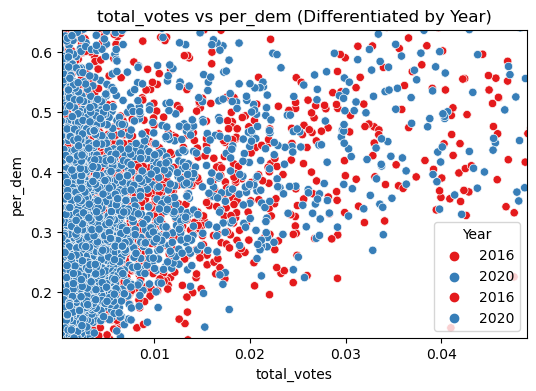

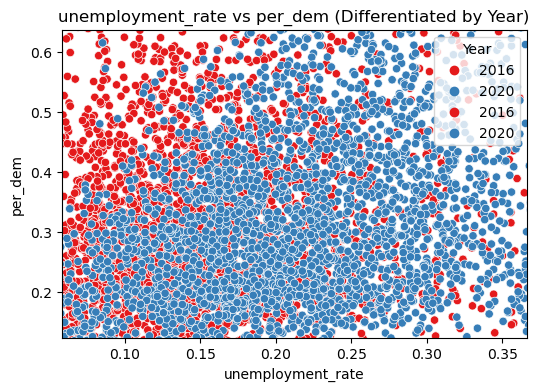

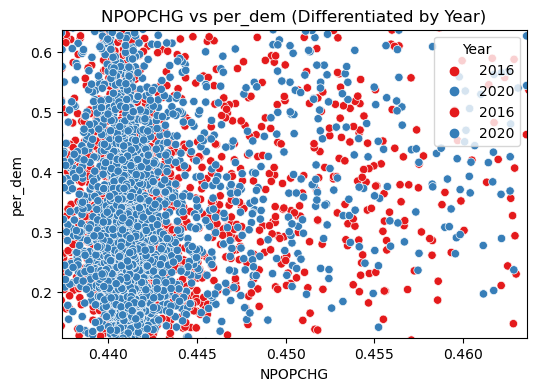

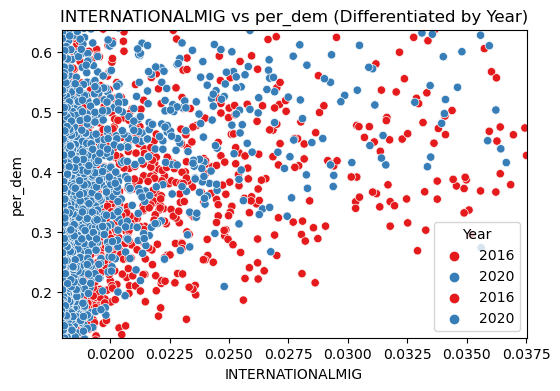

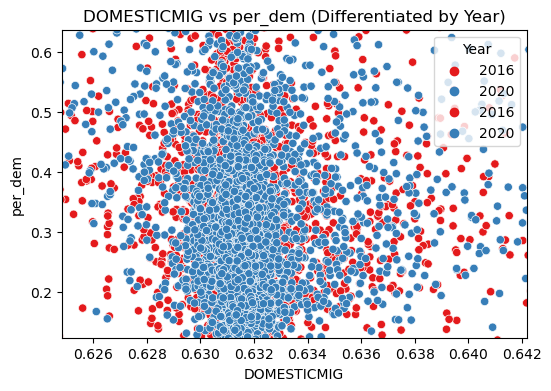

...

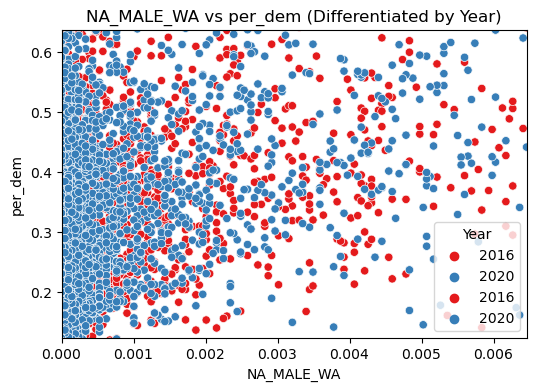

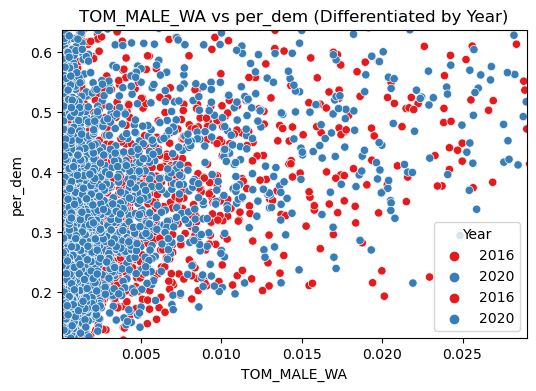

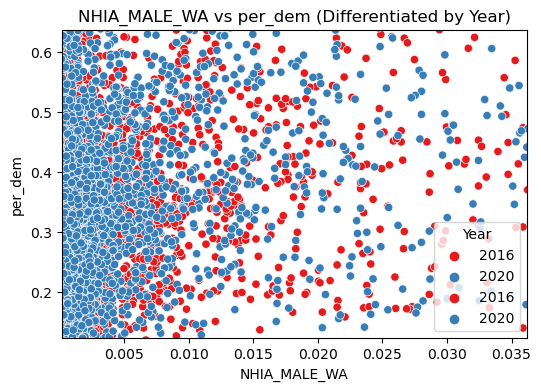

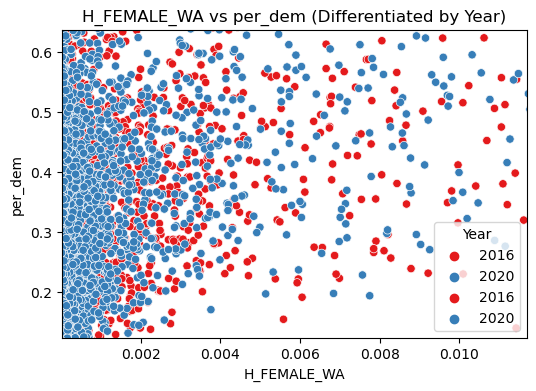

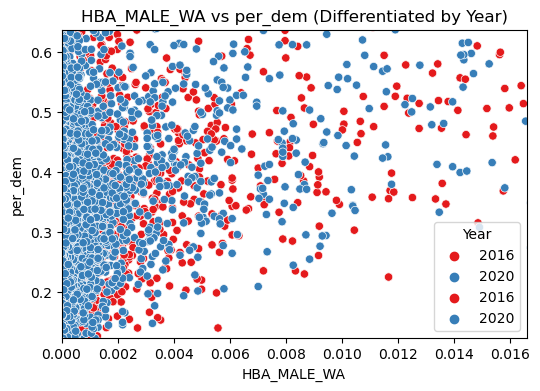

In [11]:
df = dataset[features_data.columns.tolist() + ['per_dem', 'year']]  # Include 'year' in the dataframe

df_scaled = df.copy()

columns_to_scale = features_data.columns

# Initialize the MinMaxScaler
scaler = MinMaxScaler()

# Fit and transform the data
df_scaled[columns_to_scale] = pd.DataFrame(scaler.fit_transform(df_scaled[columns_to_scale]))

# Plot scatter plots for each feature with the target variable, differentiated by year
for column in df_scaled.drop(columns=['per_dem', 'year']).columns:
    plt.figure(figsize=(6, 4))

    # Get the limits to zoom in on the data's concentration
    x_min, x_max = df_scaled[column].quantile([0.05, 0.95])  # 5th and 95th percentile for X-axis
    y_min, y_max = df_scaled['per_dem'].quantile([0.05, 0.95])  # 5th and 95th percentile for Y-axis
    
    # Plotting the scatter plot
    sns.scatterplot(data=df_scaled, x=column, y='per_dem', hue='year', palette='Set1')
    
    # Set the axis limits to zoom in
    plt.xlim(x_min, x_max)
    plt.ylim(y_min, y_max)

    sns.scatterplot(data=df_scaled, x=column, y='per_dem', hue='year', palette='Set1')  # Color by year
    plt.title(f'{column} vs per_dem (Differentiated by Year)')
    plt.legend(title='Year')  # Add legend to differentiate the years
    plt.show()


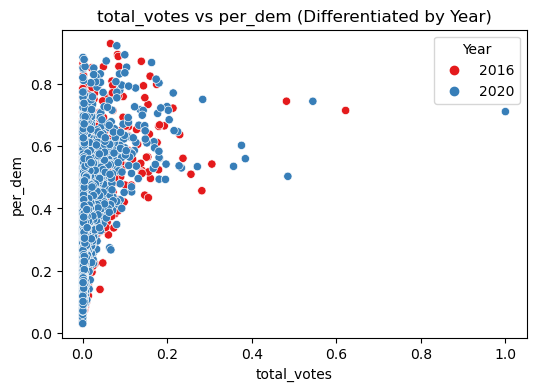

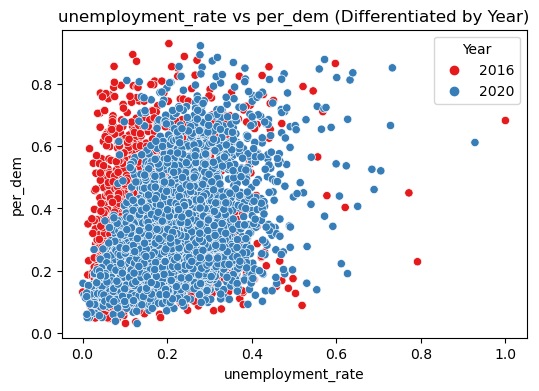

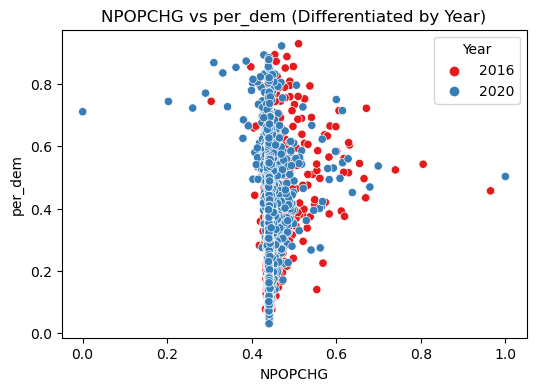

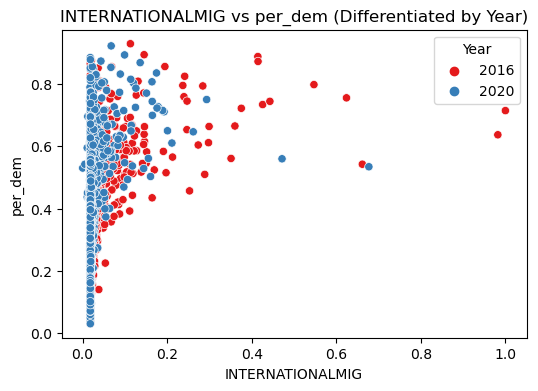

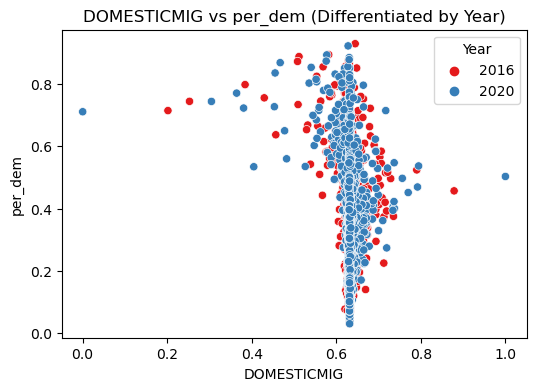

...

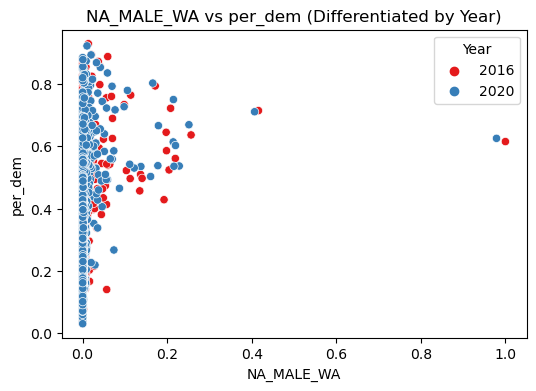

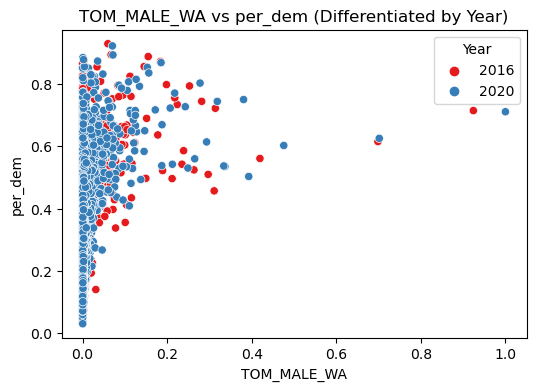

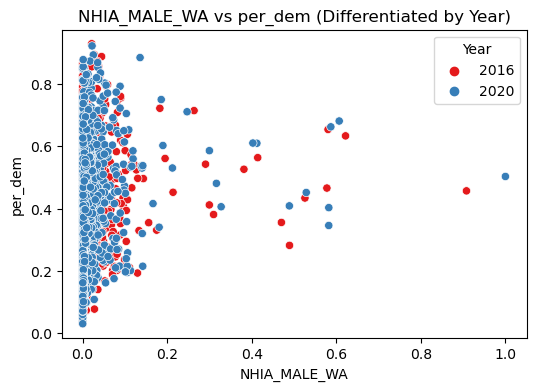

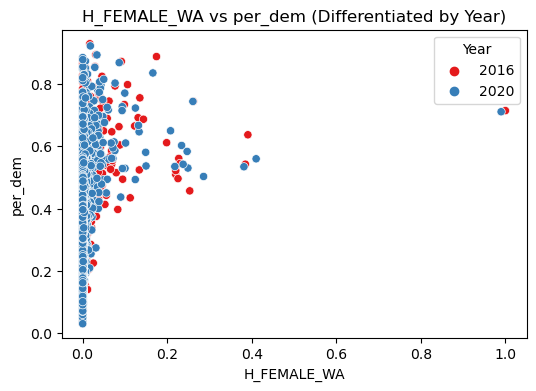

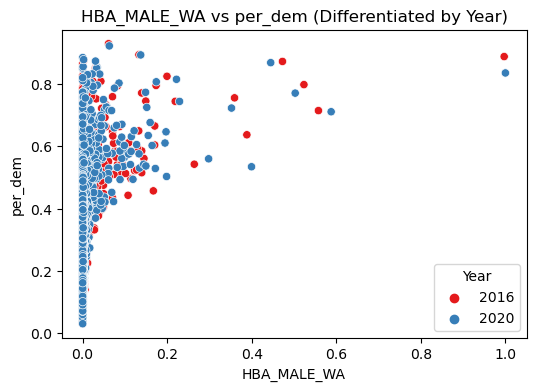

In [36]:
df = dataset[features_data.columns.tolist() + ['per_dem', 'year']]  # Include 'year' in the dataframe

df_scaled = df.copy()

columns_to_scale = features_data.columns

# Initialize the MinMaxScaler
scaler = MinMaxScaler()

# Fit and transform the data
df_scaled[columns_to_scale] = pd.DataFrame(scaler.fit_transform(df_scaled[columns_to_scale]))

# Plot scatter plots for each feature with the target variable, differentiated by year
for column in df_scaled.drop(columns=['per_dem', 'year']).columns:
    plt.figure(figsize=(6, 4))
    sns.scatterplot(data=df_scaled, x=column, y='per_dem', hue='year', palette='Set1')  # Color by year
    plt.title(f'{column} vs per_dem (Differentiated by Year)')
    plt.legend(title='Year')  # Add legend to differentiate the years
    plt.show()


Statistics

In [13]:
features_data.describe()

,total_votes,unemployment_rate,NPOPCHG,INTERNATIONALMIG,DOMESTICMIG,RESIDUAL,GQESTIMATES,RBIRTH,RDEATH,RNATURALINC,...,adjusted_gop_pct_estimate,adjusted_gop_pct_bo_avg,BA_MALE_WA,IA_MALE_WA,AA_MALE_WA,NA_MALE_WA,TOM_MALE_WA,NHIA_MALE_WA,H_FEMALE_WA,HBA_MALE_WA
count,6.169000e+03,6169.000000,6169.000000,6169.000000,6169.000000,6169.000000,6169.000000,6169.000000,6169.000000,6169.000000,...,6169.000000,6169.000000,6169.000000,6169.000000,6169.000000,6169.000000,6169.000000,6169.000000,6.169000e+03,6169.000000
mean,4.650978e+04,5.971947,548.005836,238.187064,2.961258,0.019128,2582.554061,11.203083,10.774685,0.428398,...,0.521708,0.357839,2782.995461,275.406063,1366.514022,58.420490,429.632517,146.574485,3.891569e+03,183.993354
std,1.337393e+05,2.211996,3446.094618,1429.016882,3428.723667,116.454114,6741.426646,2.512745,2.822323,4.177573,...,0.098112,0.133810,11330.275138,1188.362703,9610.452408,489.641699,1922.661190,610.773275,2.703942e+04,1149.725288
min,6.400000e+01,1.625000,-68556.000000,-781.000000,-110428.000000,-3770.000000,0.000000,0.000000,0.000000,-16.712112,...,0.234090,0.030780,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000e+00,0.000000
25%,5.060000e+03,4.400000,-118.000000,1.000000,-149.000000,-5.000000,176.000000,9.682186,8.962525,-2.212015,...,0.447300,0.254920,34.000000,14.000000,10.000000,1.000000,22.000000,9.000000,6.000000e+01,2.000000
50%,1.177900e+04,5.691667,-3.000000,9.000000,-21.000000,0.000000,603.000000,11.058824,10.847417,0.188573,...,0.526260,0.328380,235.000000,41.000000,32.000000,4.000000,54.000000,24.000000,1.890000e+02,12.000000
75%,3.136300e+04,7.208333,220.000000,48.000000,133.000000,2.000000,2268.000000,12.436195,12.650949,2.799630,...,0.597120,0.472650,1326.000000,138.000000,164.000000,17.000000,192.000000,83.000000,9.490000e+02,45.000000
max,4.263443e+06,24.183333,86820.000000,42607.000000,64403.000000,2555.000000,180231.000000,29.434867,22.988506,25.537983,...,0.790240,0.703930,223982.000000,36520.000000,319134.000000,20904.000000,59083.000000,16524.000000,1.046894e+06,37641.000000


In [14]:
target_data.describe()

,per_gop,per_dem
count,6169.000000,6169.000000
mean,0.642779,0.325038
std,0.158827,0.156756
min,0.041221,0.030909
25%,0.552914,0.207352
50%,0.674368,0.290768
75%,0.760996,0.414677
max,0.961818,0.928466
